### Problem Statement
The proliferation of misinformation, especially in digital and social media platforms, has become a critical issue. Fake news can manipulate public opinion, influence elections, cause societal division, and even lead to harmful consequences. Fake news detection systems aim to automatically identify misleading or false information to mitigate these effects.

**Fake News Detection** is a widely researched use case in the field of natural language processing (NLP) and machine learning, aimed at identifying and mitigating the spread of misinformation. The primary goal is to develop systems that can automatically classify news articles, social media posts, or other forms of content as either genuine or fake.

### **Importing Libraries**

In [ ]:
### Importing necessary libraries

# Data manipulation and analysis
import pandas as pd  # For handling structured data
import numpy as np  # For numerical computations

# Data visualization
import matplotlib.pyplot as plt  # Basic plotting library
import seaborn as sns  # Advanced statistical visualizations

# Text preprocessing
import re  # Regular expressions for text cleaning
import nltk 
from nltk.corpus import stopwords  # Stopwords removal
#from nltk.stem.porter import PorterStemmer  # Stemming words to root form

# to donwload the stopwords
nltk.download('stopwords')

# Feature extraction for text data
from sklearn.feature_extraction.text import TfidfVectorizer  # Convert text to TF-IDF features

# Model selection and evaluation
from sklearn.model_selection import train_test_split
#from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score  # Data splitting and cross-validation
from sklearn.metrics import classification_report, log_loss,roc_auc_score,roc_curve, auc # Model evaluation metrics
from sklearn.metrics import accuracy_score , confusion_matrix , ConfusionMatrixDisplay # Model evaluation metrics
from sklearn.naive_bayes import GaussianNB

# WordCloud visualization
#from PIL import Image  # Image handling for WordCloud masks
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator  # WordCloud creation and styling

# Machine learning models
from sklearn.ensemble import RandomForestClassifier  # Random Forest classifier
from sklearn.linear_model import LogisticRegression  # Logistic Regression classifier
from sklearn.ensemble import GradientBoostingClassifier  # Gradient Boosting classifier

# Hyperparameter tuning
#from sklearn.model_selection import GridSearchCV  # Grid Search for best hyperparameters

# Model persistence
#import pickle  # Save and load trained models

# Machine learning pipeline utilities
#from sklearn.pipeline import Pipeline  # Creating ML pipelines
#from sklearn.preprocessing import FunctionTransformer  # Custom transformations in pipeline

# extra lib import
import textwrap


[nltk_data] Downloading package stopwords to /home/bhumukul-
[nltk_data]     raj/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [3]:
%matplotlib inline

### **Inporting Data**

In [4]:
df_train = pd.read_csv('./data-set/news_info.csv')

In [5]:
df_train

,title,text,subject,date,Label
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",Fake
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",Fake
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",Fake
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",Fake
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",Fake
...,...,...,...,...,...
44872,'Fully committed' NATO backs new U.S. approach...,BRUSSELS (Reuters) - NATO allies on Tuesday we...,worldnews,"August 22, 2017",True
44873,LexisNexis withdrew two products from Chinese ...,"LONDON (Reuters) - LexisNexis, a provider of l...",worldnews,"August 22, 2017",True
44874,Minsk cultural hub becomes haven from authorities,MINSK (Reuters) - In the shadow of disused Sov...,worldnews,"August 22, 2017",True
44875,Vatican upbeat on possibility of Pope Francis ...,MOSCOW (Reuters) - Vatican Secretary of State ...,worldnews,"August 22, 2017",True


#### **Data-set consisits of the following columns**
- **Column 1** : **title** : The title of the news article.
- **Column 2** : **text** : The text of the news article.
- **Column 3** : **subject** : The subject of the news article.
- **Column 4** : **date** : The date of the news article.
- **Column 5** : **label** : The label of the news article.



In [6]:
df_train['subject'].value_counts()

subject
politicsNews       11261
worldnews          10145
News                9040
politics            6841
left-news           4459
Government News     1570
US_News              783
Middle-east          778
Name: count, dtype: int64

In [7]:
df_train['subject'].unique()

array(['News', 'politics', 'Government News', 'left-news', 'US_News',
       'Middle-east', 'politicsNews', 'worldnews'], dtype=object)

In [8]:


sample_text = df_train[df_train['Label']=="True"].sample(n = 1)['text'].values[0]
wrapped_text = textwrap.fill(sample_text, width=80)  # Adjust width as needed
print(wrapped_text)

SPRINGFIELD, Ill. (Reuters) - Just days before the end of the Illinois
legislature’s spring session, the governor said on Sunday he would veto a House-
passed budget, which includes school funding, and fired back at an angry Chicago
mayor. Lawmakers face a midnight Tuesday deadline to pass a fiscal 2017 budget
and adopt a 2016 spending plan that has remained elusive for the past 11 months,
leaving Illinois as the only state without a complete budget for the fiscal year
ending June 30.  The impasse between the Republican governor and Democrats who
control the legislature showed strong signs of extending into fiscal 2017, with
Bruce Rauner pushing for pro-business and anti-union reforms and Democrats in
the House of Representatives last week passing a spending plan short about $7
billion in revenue.  Adding fuel to the fire was Rauner’s veto on Friday of a
bill allowing Chicago to spread out payments to its public safety workers’
retirement systems as the city struggles with a structural

In [9]:
df_train.shape

(44877, 5)

In [10]:
df_train.describe()

,title,text,subject,date,Label
count,44877,44877,44877,44877,44877
unique,38708,38625,8,2397,2
top,Factbox: Trump fills top jobs for his administ...,,politicsNews,"December 20, 2017",Fake
freq,14,627,11261,182,23471


In [11]:
df_train.head()



,title,text,subject,date,Label
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",Fake
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",Fake
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",Fake
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",Fake
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",Fake


In [12]:
df_train.isnull().sum()

title      0
text       0
subject    0
date       0
Label      0
dtype: int64

In [13]:
df_train.duplicated().sum()

209

In [14]:
df_train.drop_duplicates(inplace=True)

In [15]:
df_train.duplicated().sum()

0

In [16]:
df_train

,title,text,subject,date,Label
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",Fake
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",Fake
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",Fake
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",Fake
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",Fake
...,...,...,...,...,...
44872,'Fully committed' NATO backs new U.S. approach...,BRUSSELS (Reuters) - NATO allies on Tuesday we...,worldnews,"August 22, 2017",True
44873,LexisNexis withdrew two products from Chinese ...,"LONDON (Reuters) - LexisNexis, a provider of l...",worldnews,"August 22, 2017",True
44874,Minsk cultural hub becomes haven from authorities,MINSK (Reuters) - In the shadow of disused Sov...,worldnews,"August 22, 2017",True
44875,Vatican upbeat on possibility of Pope Francis ...,MOSCOW (Reuters) - Vatican Secretary of State ...,worldnews,"August 22, 2017",True


In [17]:
# lefs fix index

df_train.reset_index(drop=True, inplace=True)

In [18]:
df_train

,title,text,subject,date,Label
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",Fake
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",Fake
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",Fake
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",Fake
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",Fake
...,...,...,...,...,...
44663,'Fully committed' NATO backs new U.S. approach...,BRUSSELS (Reuters) - NATO allies on Tuesday we...,worldnews,"August 22, 2017",True
44664,LexisNexis withdrew two products from Chinese ...,"LONDON (Reuters) - LexisNexis, a provider of l...",worldnews,"August 22, 2017",True
44665,Minsk cultural hub becomes haven from authorities,MINSK (Reuters) - In the shadow of disused Sov...,worldnews,"August 22, 2017",True
44666,Vatican upbeat on possibility of Pope Francis ...,MOSCOW (Reuters) - Vatican Secretary of State ...,worldnews,"August 22, 2017",True


## **Data Visualization**

#### **Analysis**


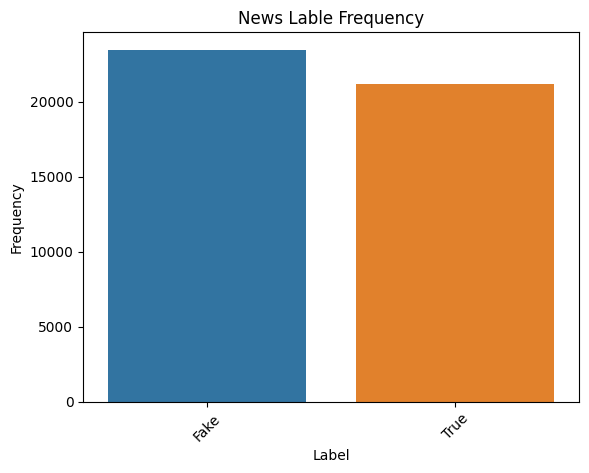

In [19]:
sns.countplot(x=df_train['Label'])
plt.title('News Lable Frequency')
plt.xticks(rotation=45)
plt.ylabel('Frequency')
plt.xlabel('Label')
plt.show()

##### The frequency of Fake news is slightly above true news based on out data

In [20]:
df_train['Label'].unique()

array(['Fake', 'True'], dtype=object)

In [21]:
fdt_lable =df_train['Label'].value_counts()


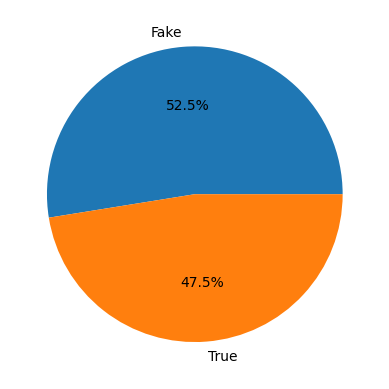

In [22]:
plt.pie(fdt_lable, labels=fdt_lable.index, autopct='%1.1f%%')
plt.show()

In [23]:
df_top = df_train.copy()
df_top_group = df_top.subject.value_counts()
df_top_group

subject
politicsNews       11209
worldnews           9991
News                9040
politics            6838
left-news           4459
Government News     1570
US_News              783
Middle-east          778
Name: count, dtype: int64

#### **News Content Distribution**
#### Most of the news are related to politics

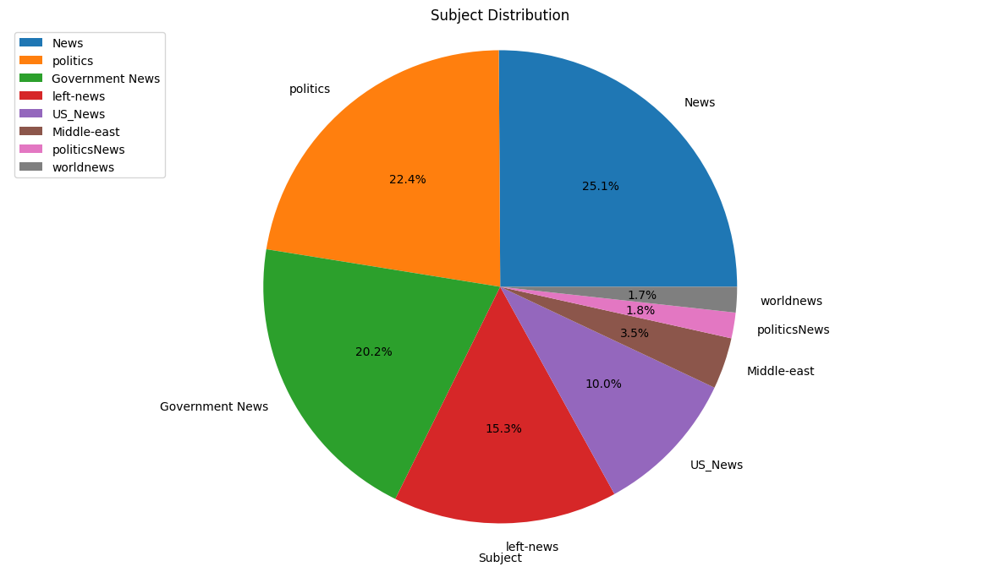

In [24]:
plt.figure(figsize=(15, 8))
plt.pie(df_top_group, labels=df_top.subject.unique(), autopct='%1.1f%%')
plt.title('Subject Distribution')
plt.xlabel('Subject')
plt.legend(df_top.subject.unique(),loc='upper left')
plt.axis('equal') 
plt.show()

In [25]:
df_train

,title,text,subject,date,Label
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",Fake
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",Fake
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",Fake
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",Fake
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",Fake
...,...,...,...,...,...
44663,'Fully committed' NATO backs new U.S. approach...,BRUSSELS (Reuters) - NATO allies on Tuesday we...,worldnews,"August 22, 2017",True
44664,LexisNexis withdrew two products from Chinese ...,"LONDON (Reuters) - LexisNexis, a provider of l...",worldnews,"August 22, 2017",True
44665,Minsk cultural hub becomes haven from authorities,MINSK (Reuters) - In the shadow of disused Sov...,worldnews,"August 22, 2017",True
44666,Vatican upbeat on possibility of Pope Francis ...,MOSCOW (Reuters) - Vatican Secretary of State ...,worldnews,"August 22, 2017",True


In [26]:
pd.crosstab(df_train['subject'], df_train['Label'])

Label,Fake,True
subject,,
Government News,1570,0
Middle-east,778,0
News,9040,0
US_News,783,0
left-news,4459,0
politics,6838,0
politicsNews,0,11209
worldnews,0,9991


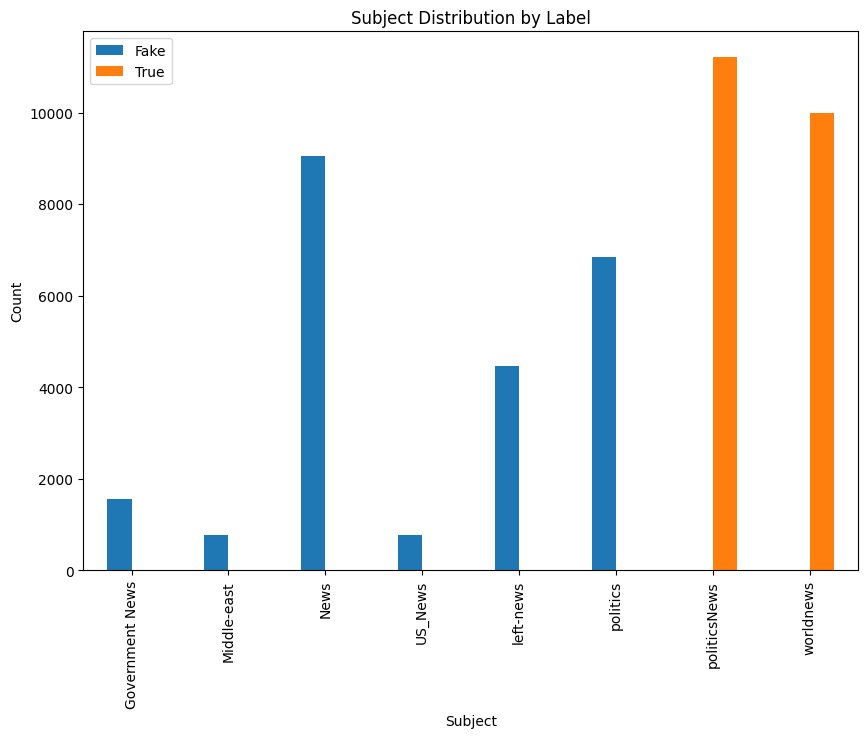

In [27]:
pd.crosstab(df_train['subject'], df_train['Label']).plot(kind='bar',  figsize=(10, 7))
plt.title('Subject Distribution by Label')
plt.xlabel('Subject')
plt.ylabel('Count')
plt.legend(df_train['Label'].unique(), loc='upper left')
plt.show()



#### **Observation : News Labeling**
#### we can notice that only news labeled as politics and worldnews are true, while other subjects are fake therefore.

In [28]:
df_train.loc[df_train['subject'] == 'politicsNews','Label'].unique()

array(['True'], dtype=object)

In [29]:
df_train = df_train.sample(frac=0.1)


In [30]:
# {} key -- word # count of the word
para = " ".join(df_train["text"])
wrapped_text = textwrap.fill(para, width=80)  # Adjust width as needed
print(wrapped_text)

Donald Trump hired himself a personal lawyer to represent him in the Russia
investigation. Marc Kasowitz, though, isn t a criminal attorney or a
constitutional attorney. He s a corporate and real estate attorney, and if his
response to former FBI head James Comey s testimony on Thursday is any
indication, he s not good with details. The response is riddled with errors   he
(or his staff) even misspelled the word  President. While the statement is a
pretty standard attempt to paint a rosy picture on Comey s testimony (it was
released before the testimony), but it s difficult to take seriously.The letter
begins,  I am Marc Kasowitz, Predisent Trump s personal lawyer.  Clearly
Kasowitz isn t familiar with spellcheck, because mine really fought that
misspelling.The letter also misspells the name of National Intelligence Director
Dan Coats. It was spelled  Coates.  Some sentences had extra periods.Here s the
full letter:Twitter had a field day with the errors:TRUMP S LAWYER: If I say the
*p

In [31]:
sw_list = stopwords.words("english")

sw_list

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [32]:
word_count = {}
for each_word in para.split():
    if each_word.lower() in sw_list:
        if each_word in word_count :
            word_count[each_word] += 1
        else :
            word_count[each_word] = 1
        

In [33]:
pd.Series(para.split()).value_counts()

the               90355
to                52800
of                43779
and               39175
a                 38664
                  ...  
Chirlane              1
insensitivity.        1
Cosmopolitan          1
Blasio’s              1
6.6086                1
Name: count, Length: 109338, dtype: int64

In [34]:
word_count

{'himself': 400,
 'a': 38664,
 'to': 52800,
 'him': 1806,
 'in': 32095,
 'the': 90355,
 'isn': 310,
 't': 3982,
 'or': 3769,
 'He': 2335,
 's': 16863,
 'and': 39175,
 'if': 2385,
 'his': 8911,
 'on': 18236,
 'is': 15985,
 'any': 1929,
 'he': 10236,
 'not': 7571,
 'with': 11060,
 'The': 9750,
 'While': 377,
 'was': 11209,
 'before': 1491,
 'but': 4008,
 'it': 8667,
 'I': 5554,
 'am': 368,
 'because': 1890,
 'that': 21652,
 'of': 43779,
 'It': 2326,
 'Some': 308,
 'had': 4435,
 'S': 79,
 'If': 817,
 'did': 1521,
 'm': 576,
 'doesn': 485,
 'can': 2501,
 'over': 2567,
 'you': 3371,
 'under': 1215,
 'all': 2855,
 'for': 16708,
 'me': 563,
 'i': 21,
 'both': 888,
 'as': 9710,
 'do': 1804,
 'few': 502,
 'Not': 214,
 'this': 5742,
 'an': 6529,
 'This': 1299,
 'As': 545,
 'has': 8844,
 'will': 4727,
 'be': 8248,
 'Up': 11,
 'until': 505,
 'from': 7886,
 'during': 1409,
 'their': 4363,
 'down': 990,
 'its': 3034,
 'by': 9370,
 'at': 7043,
 'out': 2959,
 'against': 2234,
 'now': 1312,
 'other': 2

In [35]:
para = " ".join(df_train[df_train["Label"] == "Fake"]["text"])
word_count_fake_news = {}
for each_word in para.split():
    if each_word in word_count_fake_news :
        word_count_fake_news[each_word] += 1
    else :
        word_count_fake_news[each_word] = 1
        

In [36]:
word_count_fake_news

{'Donald': 1652,
 'Trump': 6120,
 'hired': 43,
 'himself': 275,
 'a': 19678,
 'personal': 184,
 'lawyer': 84,
 'to': 27692,
 'represent': 53,
 'him': 1168,
 'in': 14967,
 'the': 47106,
 'Russia': 412,
 'investigation.': 37,
 'Marc': 14,
 'Kasowitz,': 2,
 'though,': 104,
 'isn': 306,
 't': 3753,
 'criminal': 192,
 'attorney': 85,
 'or': 2224,
 'constitutional': 52,
 'attorney.': 5,
 'He': 1412,
 's': 12409,
 'corporate': 60,
 'and': 20716,
 'real': 324,
 'estate': 46,
 'attorney,': 11,
 'if': 1446,
 'his': 5181,
 'response': 224,
 'former': 633,
 'FBI': 423,
 'head': 155,
 'James': 191,
 'Comey': 220,
 'testimony': 50,
 'on': 7550,
 'Thursday': 116,
 'is': 10393,
 'any': 1075,
 'indication,': 3,
 'he': 5780,
 'not': 3912,
 'good': 419,
 'with': 5747,
 'details.': 7,
 'The': 3944,
 'riddled': 4,
 'errors': 9,
 '(or': 47,
 'staff)': 1,
 'even': 1185,
 'misspelled': 6,
 'word': 113,
 'President.': 43,
 'While': 205,
 'statement': 280,
 'pretty': 187,
 'standard': 49,
 'attempt': 130,
 'pai

In [37]:
para = " ".join(df_train[df_train["Label"] == "True"]["text"])
word_count_true_news = {}
for each_word in para.split():
    if each_word in word_count_true_news :
        word_count_true_news[each_word] += 1
    else :
        word_count_true_news[each_word] = 1

In [38]:
word_count_true_news

{'WASHINGTON': 672,
 '(Reuters)': 2154,
 '-': 3237,
 'Several': 47,
 'Democratic': 831,
 'members': 349,
 'of': 21064,
 'the': 43249,
 'U.S.': 3916,
 'Senate': 774,
 'and': 18459,
 'House': 1385,
 'Representatives': 210,
 'asked': 352,
 'on': 10686,
 'Wednesday': 425,
 'for': 8084,
 'an': 3242,
 'investigation': 228,
 'into': 992,
 'a': 18986,
 'report': 217,
 'that': 8498,
 'Health': 60,
 'Human': 84,
 'Services': 62,
 'Secretary': 311,
 'Tom': 64,
 'Price': 32,
 'used': 287,
 'private': 194,
 'jets': 23,
 'to': 25108,
 'travel': 192,
 'government': 1504,
 'business.': 17,
 'Politico': 23,
 'reported': 249,
 'Tuesday': 487,
 'took': 309,
 'five': 213,
 'occasions': 8,
 'official': 610,
 'business,': 19,
 'which': 2150,
 'cost': 133,
 'tens': 36,
 'thousands': 182,
 'dollars': 68,
 'more': 1727,
 'than': 1234,
 'commercial': 46,
 'flights.': 8,
 'documented': 7,
 'one': 1057,
 'chartered': 4,
 'trip': 95,
 'Philadelphia': 19,
 'from': 3977,
 'Washington': 431,
 'about': 1717,
 '$25,000

### **Word Cloud**

In [39]:
text = " ".join(text for text in df_train.loc[df_train['Label'] == 'Fake','text'])
wordcloud = WordCloud(background_color='white',max_words=200,colormap='magma').generate(text)

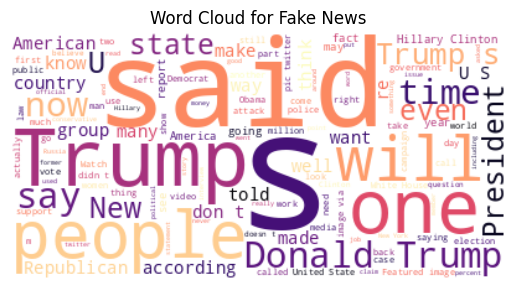

In [40]:
plt.imshow(wordcloud,interpolation='bilinear') # imshow is stands for image showing
plt.axis('off')
plt.title('Word Cloud for Fake News')
plt.show()


**All News Words Cloud**

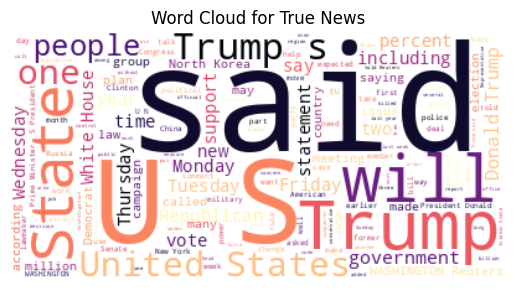

In [41]:
text = " ".join(text for text in df_train.loc[df_train['Label'] == 'True','text'])
wordcloud = WordCloud(background_color="white",max_words=200,colormap="magma").generate(text)
plt.imshow(wordcloud , interpolation="bilinear",)
plt.axis("off")
plt.title('Word Cloud for True News')
plt.show()

##### **Spliting the Data**

In [42]:
y = df_train['Label']
x = df_train['text']

In [43]:
y.unique()

array(['Fake', 'True'], dtype=object)

In [44]:
y

1212     Fake
22075    Fake
25094    True
11664    Fake
4095     Fake
         ... 
25047    True
7078     Fake
65       Fake
26532    True
37387    True
Name: Label, Length: 4467, dtype: object

### **Text PreProcessing**

In [45]:
def text_preprocessing(content):

    #remove unwanted information
    content = re.sub('[^a-zA-Z\s]',' ',content)   # re stands for regex pattern
    # notmalize the case
    content = content.lower()

    return content

In [46]:
x = x.apply(text_preprocessing)

In [47]:
x

1212     donald trump hired himself a personal lawyer t...
22075     image  air defense and satellite tracking cen...
25094    washington  reuters    several democratic memb...
11664    on thursday  new hampshire s federal elections...
4095     republicans have a knack for making bad choice...
                               ...                        
25047    washington  reuters    protesters at howard un...
7078     the members of a roman catholic church in pola...
65       over the last few weeks  i ve watched as the l...
26532    washington  reuters    senate republicans woul...
37387    shanghai  reuters    police in southern china ...
Name: text, Length: 4467, dtype: object

### **Train Test Split**

In [48]:
x_train, x_test,y_train,y_test = train_test_split(x, y, test_size= 0.2,random_state=40,stratify=y)

# TF-IDF Vectorization

## Overview
TF-IDF (Term Frequency-Inverse Document Frequency) is a technique used to represent text data numerically. It converts a collection of raw documents into a matrix of TF-IDF features, where each row represents a document and each column represents a unique term in the corpus. TF-IDF takes into account both the frequency of a term in a document (TF) and the rarity of the term across all documents (IDF).

## Implementation

In our preprocessing pipeline, we apply TF-IDF vectorization to convert the text data into numerical features. This process involves the following steps:
- **Tokenization**: Breaking down the text into individual words or tokens.
- **TF Calculation**: Computing the frequency of each term in each document.
- **IDF Calculation**: Calculating the inverse document frequency of each term.
- **TF-IDF Computation**: Combining TF and IDF to compute the TF-IDF score for each term in each document.

In [49]:
# Initialize instance of class TfidfVectorizer
vectorization = TfidfVectorizer()

In [50]:
xv_train = vectorization.fit_transform(x_train)
xv_test = vectorization.transform(x_test)

In [51]:
len(vectorization.get_feature_names_out())

38994

In [52]:
xv_train = xv_train.toarray() # type: ignore

In [53]:
tfid_table = pd.DataFrame(xv_train,columns= vectorization.get_feature_names_out())

In [54]:
tfid_table

,aaa,aacnr,aaf,aagxdwkrjpq,aahy,aal,aamin,aamom,aamrrd,aapl,...,zwftuy,zwgrt,zxexim,zyi,zyklon,zzg,zzpkpmpp,zzqvyk,zztaine,zzzzzzzzzzzzz
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3568,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3569,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3570,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3571,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## **Model Training**
### **Rendom Forest Model**

In [55]:
rfc = RandomForestClassifier()

In [56]:
rfc.fit(xv_train,y_train)

RandomForestClassifier()

In [57]:
y_predicted = rfc.predict(xv_train)
rfc_accuracy = accuracy_score(y_predicted,y_train)

In [58]:
rfc_accuracy

1.0

In [59]:
y_predicted = rfc.predict(xv_test)
rfc_accuracy = accuracy_score(y_predicted,y_test)

In [60]:
rfc_accuracy

0.9798657718120806

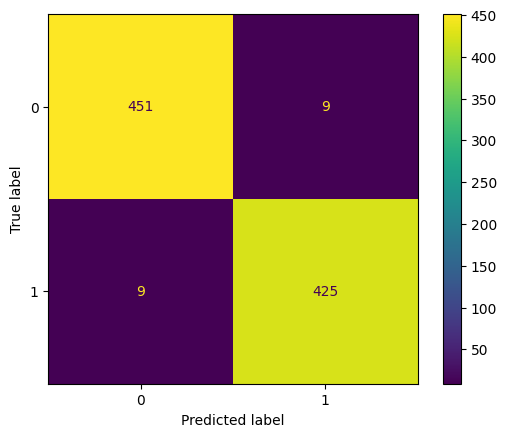

In [62]:
cm = confusion_matrix(y_test, y_predicted)

disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()

plt.show()


In [69]:
print(classification_report(y_test, y_predicted))

              precision    recall  f1-score   support

        Fake       0.98      0.98      0.98       460
        True       0.98      0.98      0.98       434

    accuracy                           0.98       894
   macro avg       0.98      0.98      0.98       894
weighted avg       0.98      0.98      0.98       894



### **Logistic Regression**

In [72]:
lgr = LogisticRegression(max_iter=1000)

In [73]:
lgr.fit(xv_train,y_train)

LogisticRegression(max_iter=1000)

In [74]:
y_predicted = lgr.predict(xv_test)

In [75]:
accuracy_score(y_predicted,y_test)

0.9686800894854586

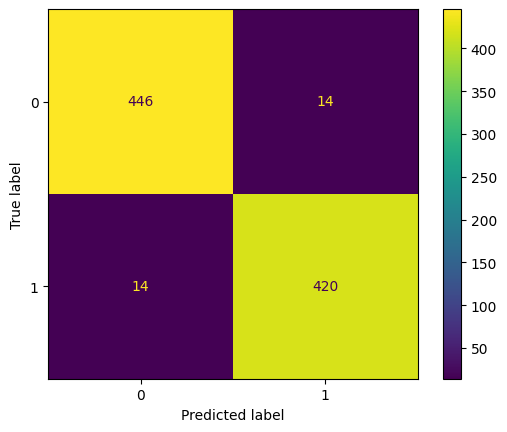

In [76]:
cm = confusion_matrix(y_test, y_predicted)

disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()

plt.show()


In [77]:
print(classification_report(y_test, y_predicted))

              precision    recall  f1-score   support

        Fake       0.97      0.97      0.97       460
        True       0.97      0.97      0.97       434

    accuracy                           0.97       894
   macro avg       0.97      0.97      0.97       894
weighted avg       0.97      0.97      0.97       894



### **Gradradient Boosting**

In [81]:
gbm = GradientBoostingClassifier()
gbm.fit(xv_train,y_train)
y_predicted = gbm.predict(xv_test)
gbm_accuracy = accuracy_score(y_test, y_predicted)

In [82]:
gbm_accuracy

0.9932885906040269

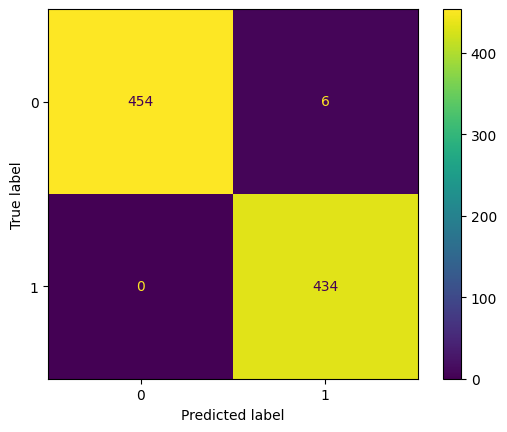

In [83]:
cm = confusion_matrix(y_test, y_predicted)

disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()

plt.show()

In [84]:
print(classification_report(y_test, y_predicted))

              precision    recall  f1-score   support

        Fake       1.00      0.99      0.99       460
        True       0.99      1.00      0.99       434

    accuracy                           0.99       894
   macro avg       0.99      0.99      0.99       894
weighted avg       0.99      0.99      0.99       894



### **Logistic Regression**

In [85]:
lgr = LogisticRegression(max_iter=1000)

In [86]:
lgr.fit(xv_train,y_train)

LogisticRegression(max_iter=1000)

In [88]:
y_predicted =lgr.predict(xv_test)

In [89]:
accuracy_score(y_test,y_predicted)

0.9686800894854586

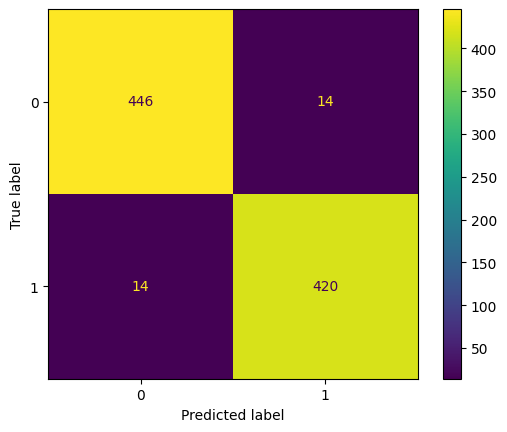

In [90]:
cm = confusion_matrix(y_test, y_predicted)

disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()

plt.show()

In [91]:
print(classification_report(y_test, y_predicted))

              precision    recall  f1-score   support

        Fake       0.97      0.97      0.97       460
        True       0.97      0.97      0.97       434

    accuracy                           0.97       894
   macro avg       0.97      0.97      0.97       894
weighted avg       0.97      0.97      0.97       894



### **GaussianNB Naive Bayes Classifier**

In [98]:
nb_model = GaussianNB()
nb_model.fit(xv_train,y_train)


GaussianNB()

In [101]:
y_predict = nb_model.predict(xv_train)
nb_accuracy = accuracy_score(y_train, y_predict)

In [102]:
nb_accuracy

0.9773299748110831

In [112]:
y_predicted = nb_model.predict(xv_test.toarray())
nb_accuracy = accuracy_score(y_predicted,y_test)

In [115]:
nb_accuracy

0.8008948545861297

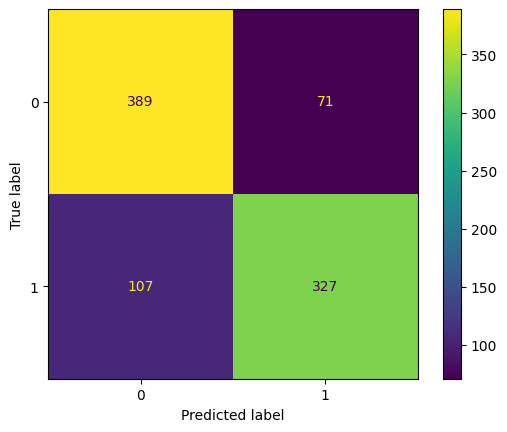

In [113]:
cm = confusion_matrix(y_test, y_predicted)

disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()

plt.show()

In [114]:
print(classification_report(y_test, y_predicted))

              precision    recall  f1-score   support

        Fake       0.78      0.85      0.81       460
        True       0.82      0.75      0.79       434

    accuracy                           0.80       894
   macro avg       0.80      0.80      0.80       894
weighted avg       0.80      0.80      0.80       894



### **Real Time Prediction**

In [126]:
def predict_news(news):
    testing_news = {'text':news}
    news_def_test = pd.DataFrame(testing_news)
    news_def_test["text"] = news_def_test["text"].apply(text_preprocessing)
    news_x_test = news_def_test["text"]
    news_xv_test = vectorization.transform(news_x_test)
    prediction= rfc.predict(news_xv_test)
    return prediction[0]


In [131]:
predict_news(df_train.sample(n=1)["text"].values)

'Fake'

### **Grid Search Results**